# WMM 25L - Laboratorium 7 - Sprawozdanie

## Analiza obrazu -detekcja twarzy

## Amadeusz Lewandowski

In [1]:
import cv2
import dlib
import insightface
import os
import numpy as np
from PIL import Image
from IPython.display import display
from time import time
from typing import Tuple, List

DETECTOR_TYPES = ["Haar", "HOG SVM", "CNN", "InsightFace"]
IMG_DIR = "images"
IMAGES = ["2_Demonstration_Demonstration_Or_Protest_2_58.jpg", "8_Election_Campain_Election_Campaign_8_244.jpg", "40_Gymnastics_Gymnastics_40_273.jpg", "0_Parade_Parade_0_873.jpg"]
CONFIG_DIR = "config"
HAAR_CONFIG = "haarcascade_frontalface_default.xml"
CNN_CONFIG = "mmod_human_face_detector.dat"
INSIGHTFACE_CONFIG = "insightface"
INSIGTHFACE_MODELS = ["buffalo_s", "buffalo_m", "buffalo_l", "buffalo_sc"]

if not os.path.exists(IMG_DIR):
    os.makedirs(IMG_DIR)

if not os.path.exists(CONFIG_DIR):
    os.makedirs(CONFIG_DIR)

def load_image(image_name: str) -> np.ndarray:
    if (not os.path.exists(f"{IMG_DIR}/{image_name}")):
        raise FileNotFoundError(f"Image {image_name} not found in {IMG_DIR}.")
    image = cv2.imread(f"{IMG_DIR}/{image_name}")
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    return image_rgb, image_gray

def display_image(image: np.ndarray) -> None:
    display(Image.fromarray(image))

# Detector initialization
if not (os.path.exists(f"{CONFIG_DIR}/{HAAR_CONFIG}")):
    raise FileNotFoundError("Haar config files not found in config directory.")

haar_detector = cv2.CascadeClassifier(f"{CONFIG_DIR}/{HAAR_CONFIG}")

def haar_detect(image_path: str, detector: cv2.CascadeClassifier, scaleFactor: float = 1.05, min_neighbors: int = 5, min_size: Tuple[int, int] = (30, 30)) -> Tuple[np.ndarray, list, float]:
    image_rgb, image_gray = load_image(image_path)

    start_time = time()
    haar_results = detector.detectMultiScale(image_gray, scaleFactor=scaleFactor, minNeighbors=min_neighbors, minSize=min_size, flags=cv2.CASCADE_SCALE_IMAGE)
    end_time = time()

    haar_image = image_rgb.copy()
    for (x, y, w, h) in haar_results:
        cv2.rectangle(haar_image, (x, y), (x + w, y + h), (0, 255, 0), 2)

    return haar_image, haar_results, float(end_time - start_time)

hog_svm_detector = dlib.get_frontal_face_detector()

def hog_svm_detect(image_path: str, detector: dlib.fhog_object_detector, upsampling: int = 1) -> Tuple[np.ndarray, list, float]:
    image_rgb, _ = load_image(image_path)

    start_time = time()
    hog_svm_results = detector(image_rgb, upsampling)
    end_time = time()

    hog_svm_image = image_rgb.copy()
    for rect in hog_svm_results:
        cv2.rectangle(hog_svm_image, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)

    return hog_svm_image, hog_svm_results, float(end_time - start_time)

if not (os.path.exists(f"{CONFIG_DIR}/{CNN_CONFIG}")):
    raise FileNotFoundError("CNN config files not found in config directory.")

cnn_detector = dlib.cnn_face_detection_model_v1(f"{CONFIG_DIR}/{CNN_CONFIG}")

def cnn_detect(image_path: str, detector: dlib.cnn_face_detection_model_v1, upsampling: int = 1) -> Tuple[np.ndarray, list, float]:
    image_rgb, _ = load_image(image_path)

    start_time = time()
    cnn_results = detector(image_rgb, upsampling)
    end_time = time()

    cnn_image = image_rgb.copy()
    for result in cnn_results:
        rect = result.rect
        cv2.rectangle(cnn_image, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)

    return cnn_image, cnn_results, float(end_time - start_time)

if not (os.path.exists(f"{CONFIG_DIR}/{INSIGHTFACE_CONFIG}")):
    raise FileNotFoundError("InsightFace config files not found in config directory.")

for model in INSIGTHFACE_MODELS:
    if not (os.path.exists(f"{CONFIG_DIR}/{INSIGHTFACE_CONFIG}/models/{model}")):
        raise FileNotFoundError(f"InsightFace model {model} not found in config directory.")

insf_detector = insightface.app.FaceAnalysis(name=INSIGTHFACE_MODELS[0], root=f"{CONFIG_DIR}/{INSIGHTFACE_CONFIG}", providers=['CPUExecutionProvider'], allowed_modules=['detection'])
insf_detector.prepare(ctx_id=0, det_size=(1024, 1024))

def insightface_detect(image_path: str, detector: insightface.app.FaceAnalysis) -> Tuple[np.ndarray, list, float]:
    image_rgb, _ = load_image(image_path)

    start_time = time()
    insightface_results = detector.get(image_rgb)
    end_time = time()

    image_insightface = image_rgb.copy()
    for res in insightface_results:
        rect = res.bbox.round().astype(int)
        cv2.rectangle(image_insightface, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)

    return image_insightface, insightface_results, float(end_time - start_time)

def process_detection_results(detection_type: str, detection_results: list, detection_time: float, GT: int, FP: int) -> Tuple:
        detected_faces = len(detection_results)

        TP = detected_faces - FP
        FN = GT - TP

        accuracy = TP / FP if FP > 0 else 0
        efficiency = TP / detected_faces if detected_faces > 0 else 0

        return (detection_type, detected_faces, GT, TP, FP, FN, detection_time, accuracy, efficiency)


def display_detection_results(processed_detection_results: Tuple) -> None:
    detection_type, detected_faces, GT, TP, FP, FN, detection_time, accuracy, efficiency = processed_detection_results

    print(f"Typ Detektora: {detection_type}")
    print(f"Liczba wykrytych twarzy na obrazie: {detected_faces}")
    print(f"Liczba twarzy na obrazie (GT): {GT}")
    print(f"Liczba poprawnych detekcji twarzy na obrazie (TP): {TP}")
    print(f"Liczba fałszywych detekcji twarzy na obrazie (FP): {FP}")
    print(f"Liczba niezydentifikowanych twarzy na obrazie (FN): {FN}")
    print(f"Czas detekcji: {detection_time:.2f}s")
    print(f"Stosunek poprawnych detekcji do fałszywych: {accuracy:.2f}")
    print(f"Stosunek poprawnych detekcji do wszystkich wykrytych: {efficiency:.2f}")

def combine_results(detection_type: str, results: List[Tuple]) -> Tuple:
    detected_faces, GT, TP, FP, FN, detection_time = 0, 0, 0, 0, 0, 0.0

    for result in results:
        detected_faces += result[1]
        GT += result[2]
        TP += result[3]
        FP += result[4]
        FN += result[5]
        detection_time += result[6]

    return (detection_type, detected_faces, GT, TP, FP, FN, detection_time)

def display_combined_results(combined_results: Tuple) -> None:
    detection_type, detected_faces, GT, TP, FP, FN, detection_time = combined_results

    print(f"Typ Detektora: {detection_type}")
    print(f"Liczba wykrytych twarzy na obrazie: {detected_faces}")
    print(f"Liczba twarzy na obrazie (GT): {GT}")
    print(f"Liczba poprawnych detekcji twarzy na obrazie (TP): {TP}")
    print(f"Liczba fałszywych detekcji twarzy na obrazie (FP): {FP}")
    print(f"Liczba niezydentifikowanych twarzy na obrazie (FN): {FN}")
    print(f"Czas detekcji: {detection_time:.2f}s")


Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: config/insightface/models/buffalo_s/det_500m.onnx detection [1, 3, '?', '?'] 127.5 128.0
set det-size: (1024, 1024)


In [2]:
haar_results_list = []
hog_svm_results_list = []
cnn_results_list = []
insightface_results_list = []

### Zadanie 1

Wykonaj detekcję czterema detektorami dla zadanego obrazu testowego.  
Zaproponuj miary efektywności algorytmów detekcji twarzy i wyznacz wartości tych miar dla obrazu 
testowego, przy czym zawsze podaj (oprócz własnych propozycji): - całkowitą liczbę twarzy w obrazie (ground truth, GT), - liczbę wszystkich detekcji (wyników zwróconych przez detektor), - liczbę poprawnie wykrytych twarzy (true positives, TP), - liczbę nie wykrytych twarzy (false negatives, FN),  - liczbę obiektów niepoprawnie rozpoznanych jako twarze (false positives, FP).  
Zastanów się, jakie relacje istnieją pomiędzy powyższymi wartościami. 
Wyniki zbierz w tabeli ułatwiającej ich porównanie.  
Zastanów się, jak potraktować wyniki detekcji, które obejmują jedynie część twarzy, albo takie, które 
oprócz twarzy zawierają również spory obszar tła (nie-twarzy). 

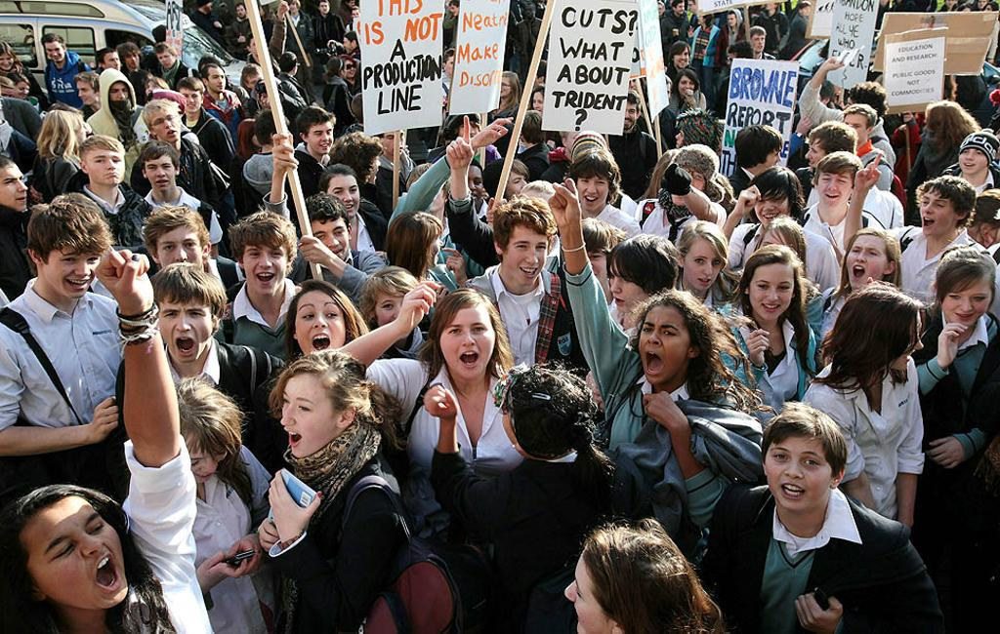

In [3]:
image, _ = load_image(IMAGES[0])
display_image(image)


Kaskada Haara


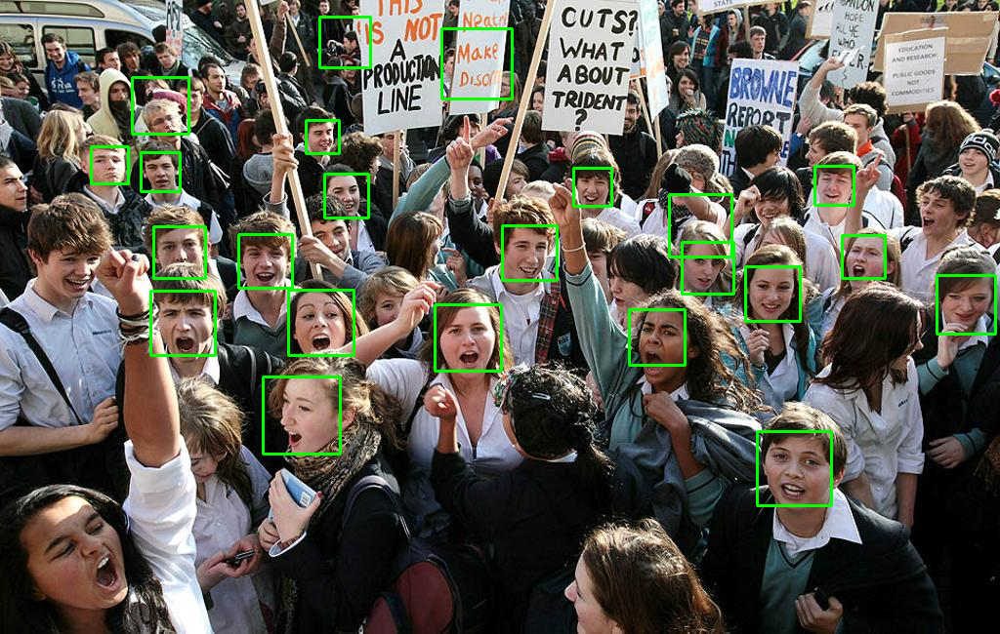

Typ Detektora: Haar
Liczba wykrytych twarzy na obrazie: 23
Liczba twarzy na obrazie (GT): 101
Liczba poprawnych detekcji twarzy na obrazie (TP): 20
Liczba fałszywych detekcji twarzy na obrazie (FP): 3
Liczba niezydentifikowanych twarzy na obrazie (FN): 81
Czas detekcji: 0.17s
Stosunek poprawnych detekcji do fałszywych: 6.67
Stosunek poprawnych detekcji do wszystkich wykrytych: 0.87


In [4]:
print("\nKaskada Haara")
haar_image, haar_results, haar_time = haar_detect(IMAGES[0], haar_detector)
display_image(haar_image)
haar_results = process_detection_results(DETECTOR_TYPES[0], haar_results, haar_time, 101, 3)
haar_results_list.append(haar_results)
display_detection_results(haar_results)


HOG-SVM


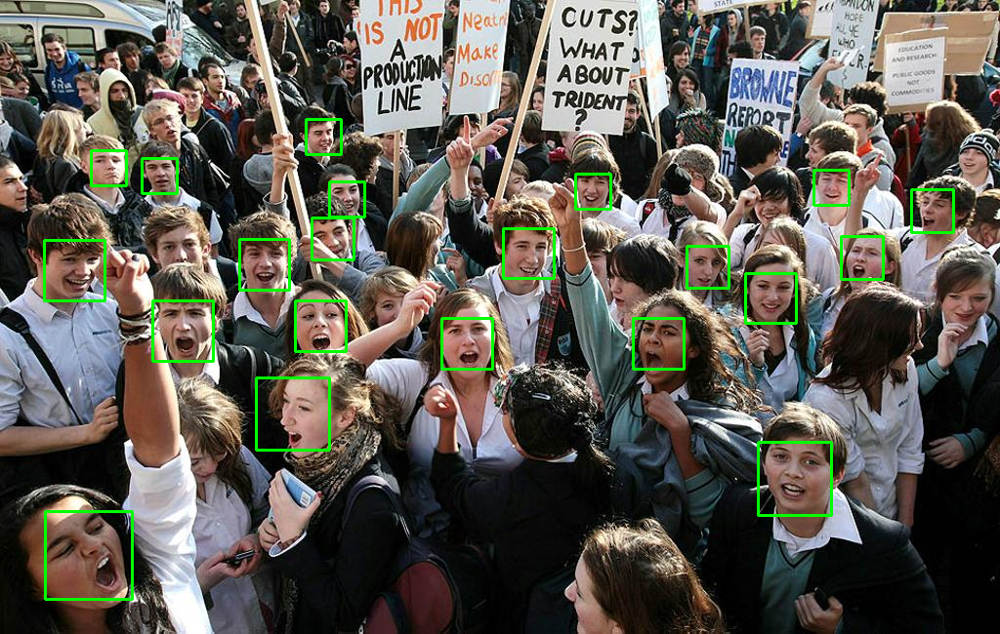

Typ Detektora: HOG SVM
Liczba wykrytych twarzy na obrazie: 21
Liczba twarzy na obrazie (GT): 101
Liczba poprawnych detekcji twarzy na obrazie (TP): 21
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 80
Czas detekcji: 0.23s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [5]:
print("\nHOG-SVM")
hog_svm_image, hog_svm_results, hog_svm_time = hog_svm_detect(IMAGES[0], hog_svm_detector)
display_image(hog_svm_image)
hog_svm_results = process_detection_results(DETECTOR_TYPES[1], hog_svm_results, hog_svm_time, 101, 0)
hog_svm_results_list.append(hog_svm_results)
display_detection_results(hog_svm_results)


CNN dlib


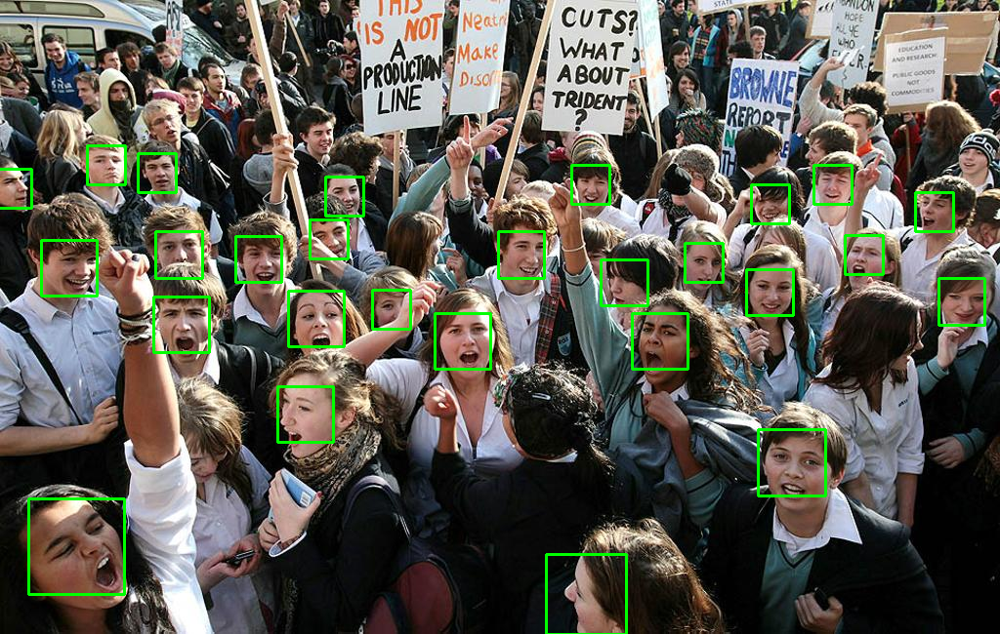

Typ Detektora: CNN
Liczba wykrytych twarzy na obrazie: 27
Liczba twarzy na obrazie (GT): 101
Liczba poprawnych detekcji twarzy na obrazie (TP): 27
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 74
Czas detekcji: 13.10s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [6]:
print("\nCNN dlib")
cnn_image, cnn_results, cnn_time = cnn_detect(IMAGES[0], cnn_detector)
display_image(cnn_image)
cnn_results = process_detection_results(DETECTOR_TYPES[2], cnn_results, cnn_time, 101, 0)
cnn_results_list.append(cnn_results)
display_detection_results(cnn_results)


InsightFace


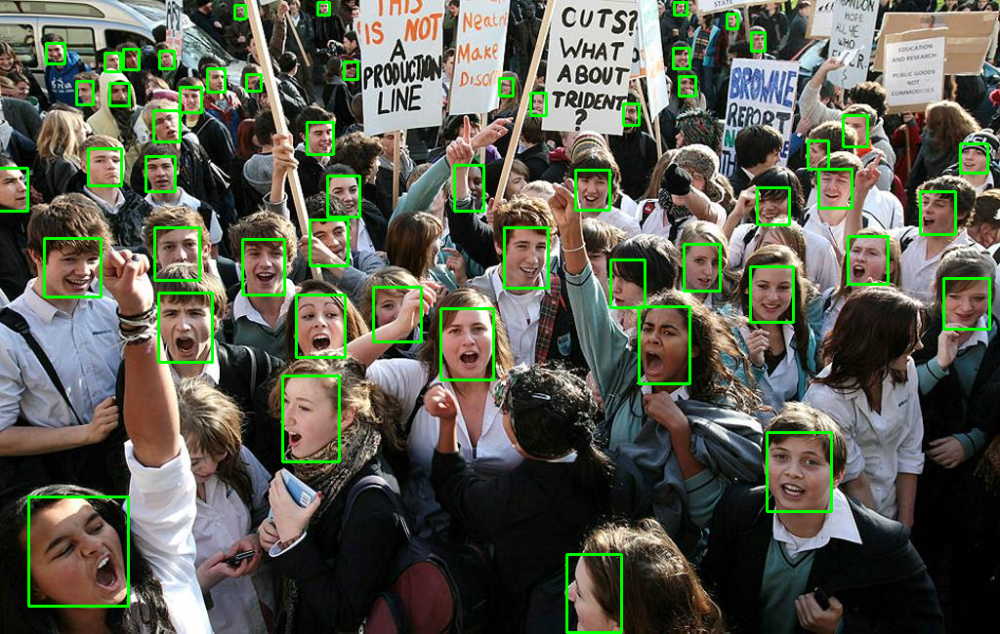

Typ Detektora: InsightFace
Liczba wykrytych twarzy na obrazie: 53
Liczba twarzy na obrazie (GT): 101
Liczba poprawnych detekcji twarzy na obrazie (TP): 53
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 48
Czas detekcji: 0.06s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [7]:
print("\nInsightFace")
insightface_image, insightface_results, insightface_time = insightface_detect(IMAGES[0], insf_detector)
display_image(insightface_image)
insightface_results = process_detection_results(DETECTOR_TYPES[3], insightface_results, insightface_time, 101, 0)
insightface_results_list.append(insightface_results)
display_detection_results(insightface_results)

#### WYNIKI

|  Detektor | Wykryte Twarze | GT | TP | FP | FN | Czas [s] | Poprawne/Fałszywe | Poprawne/Wszystkie |
|-----------|----------------|----|----|----|----|----------|-------------------|--------------------|
|Haar       |23              |101 |20  |3   |81  |0.11      |6.67               |0.87                |  
|HOG SVM    |21              |101 |21  |0   |80  |0.27      |0.00               |1.00                | 
|CNN        |27              |101 |27  |0   |74  |10.95     |0.00               |1.00                |  
|InsightFace|53              |101 |53  |0   |48  |0.10      |0.00               |1.00                | 

Wyniki detekcji, które obejmują częśc twarzy bądź inne fragmenty obrazu można uznać jako nieprawidłowe.

Jak widać InsightFace poradził sobie najlepiej, ponieważ wykrył najwięcej twarzy z obrazu i zajęło mu najkrócej i nie pomylił się.
Haar jest kiepski, ponieważ fałszywie wykrył twarze, a CNN, ponieważ jest bardzo powolny. HOG SVM nie ma takich problemów, ale wykrywa mniej twarzy od takiego InsightFace'a.

### Zadanie 2
Przygotuj dodatkowe obrazy testowe i wyznacz dla każdego z nich miary zaproponowane w pkt. 1 
(również w każdym przypadku podając wymienione tam wielkości).  
Wyniki zbierz w tabelach ułatwiających porównanie skuteczności detektorów – dla każdego obrazu 
przygotuj tabelę jak w pkt. 1. 
Sprawdź działanie detektorów na co najmniej trzech innych obrazach testowych (przykładowe obrazy 
testowe dostępne są na platformie Teams, można wykorzystać również własne obrazy), w tym 
przynajmniej jednego „trudnego” (dużo twarzy, twarze różnych rozmiarów, mocno przysłonięte, 
rozmyte, obrócone, itp. – dla prostych przypadków bez problemu można uzyskać detekcję poprawną 
w 100%). 

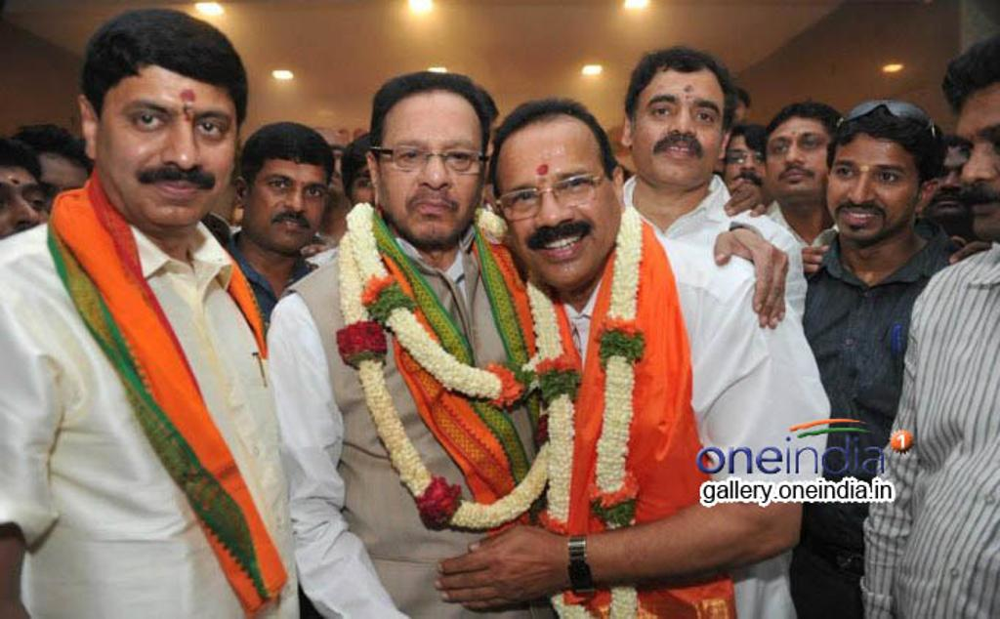

In [8]:
image, _ = load_image(IMAGES[1])
display_image(image)


Kaskada Haara


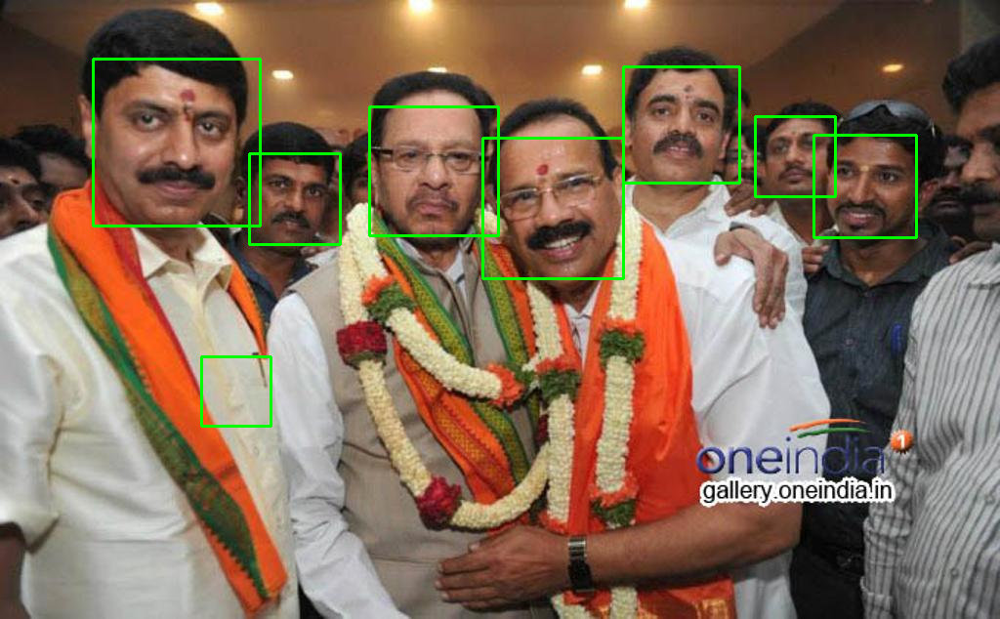

Typ Detektora: Haar
Liczba wykrytych twarzy na obrazie: 8
Liczba twarzy na obrazie (GT): 15
Liczba poprawnych detekcji twarzy na obrazie (TP): 7
Liczba fałszywych detekcji twarzy na obrazie (FP): 1
Liczba niezydentifikowanych twarzy na obrazie (FN): 8
Czas detekcji: 0.13s
Stosunek poprawnych detekcji do fałszywych: 7.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 0.88


In [9]:
print("\nKaskada Haara")
haar_image, haar_results, haar_time = haar_detect(IMAGES[1], haar_detector)
display_image(haar_image)
haar_results = process_detection_results(DETECTOR_TYPES[0], haar_results, haar_time, 15, 1)
haar_results_list.append(haar_results)
display_detection_results(haar_results)


HOG-SVM


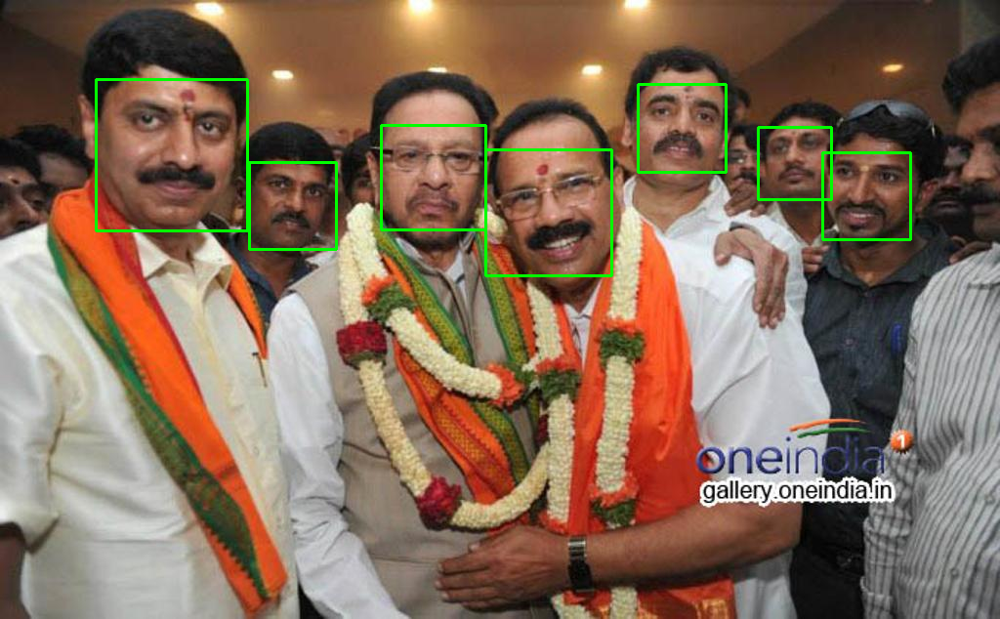

Typ Detektora: HOG SVM
Liczba wykrytych twarzy na obrazie: 7
Liczba twarzy na obrazie (GT): 15
Liczba poprawnych detekcji twarzy na obrazie (TP): 7
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 8
Czas detekcji: 0.24s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [10]:
print("\nHOG-SVM")
hog_svm_image, hog_svm_results, hog_svm_time = hog_svm_detect(IMAGES[1], hog_svm_detector)
display_image(hog_svm_image)
hog_svm_results = process_detection_results(DETECTOR_TYPES[1], hog_svm_results, hog_svm_time, 15, 0)
hog_svm_results_list.append(hog_svm_results)
display_detection_results(hog_svm_results)


CNN dlib


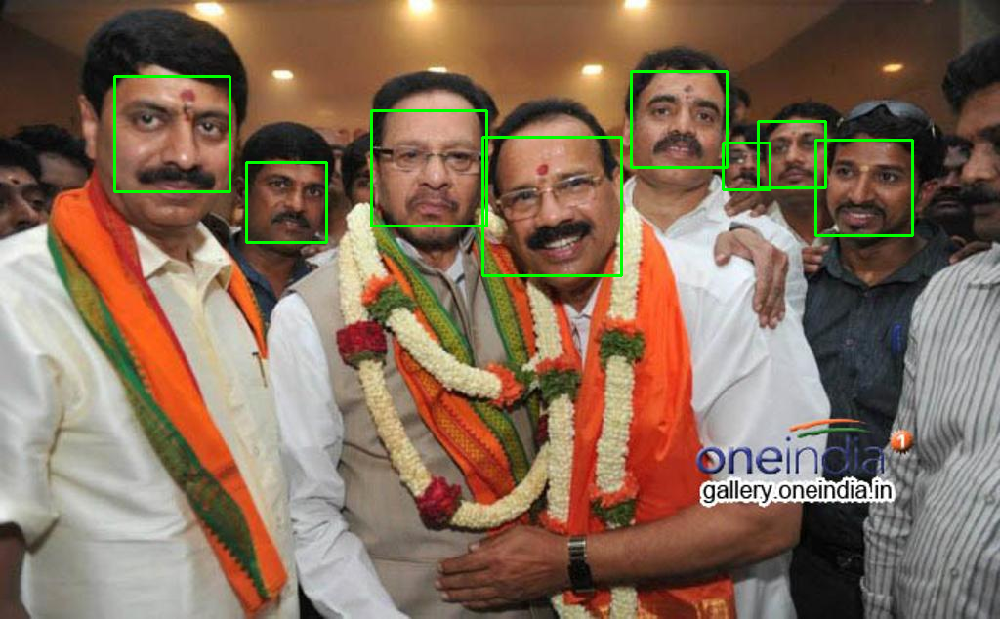

Typ Detektora: CNN
Liczba wykrytych twarzy na obrazie: 8
Liczba twarzy na obrazie (GT): 15
Liczba poprawnych detekcji twarzy na obrazie (TP): 8
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 7
Czas detekcji: 11.99s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [11]:
print("\nCNN dlib")
cnn_image, cnn_results, cnn_time = cnn_detect(IMAGES[1], cnn_detector)
display_image(cnn_image)
cnn_results = process_detection_results(DETECTOR_TYPES[2], cnn_results, cnn_time, 15, 0)
cnn_results_list.append(cnn_results)
display_detection_results(cnn_results)


InsightFace


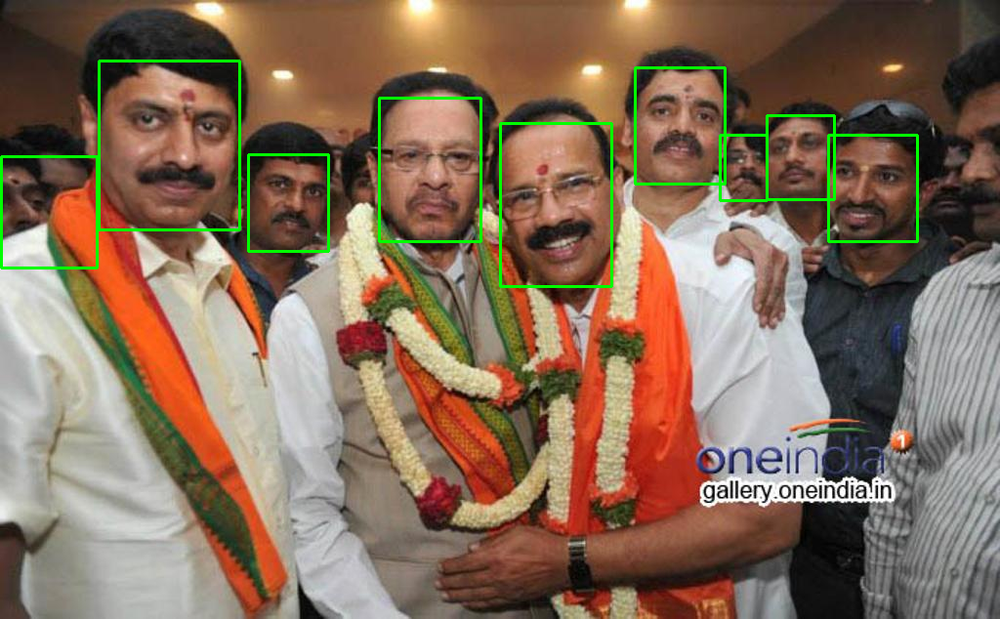

Typ Detektora: InsightFace
Liczba wykrytych twarzy na obrazie: 9
Liczba twarzy na obrazie (GT): 15
Liczba poprawnych detekcji twarzy na obrazie (TP): 9
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 6
Czas detekcji: 0.06s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [12]:
print("\nInsightFace")
insightface_image, insightface_results, insightface_time = insightface_detect(IMAGES[1], insf_detector)
display_image(insightface_image)
insightface_results = process_detection_results(DETECTOR_TYPES[3], insightface_results, insightface_time, 15, 0)
insightface_results_list.append(insightface_results)
display_detection_results(insightface_results)

#### WYNIKI

|  Detektor | Wykryte Twarze | GT | TP | FP | FN | Czas [s] | Poprawne/Fałszywe | Poprawne/Wszystkie |
|-----------|----------------|----|----|----|----|----------|-------------------|--------------------|
|Haar       |8               |15  |7   |1   |8   |0.10      |7.00               |0.88                |  
|HOG SVM    |7               |15  |7   |0   |8   |0.31      |0.00               |1.00                | 
|CNN        |8               |15  |8   |0   |7   |11.10     |0.00               |1.00                |  
|InsightFace|9               |15  |9   |0   |6   |0.06      |0.00               |1.00                | 

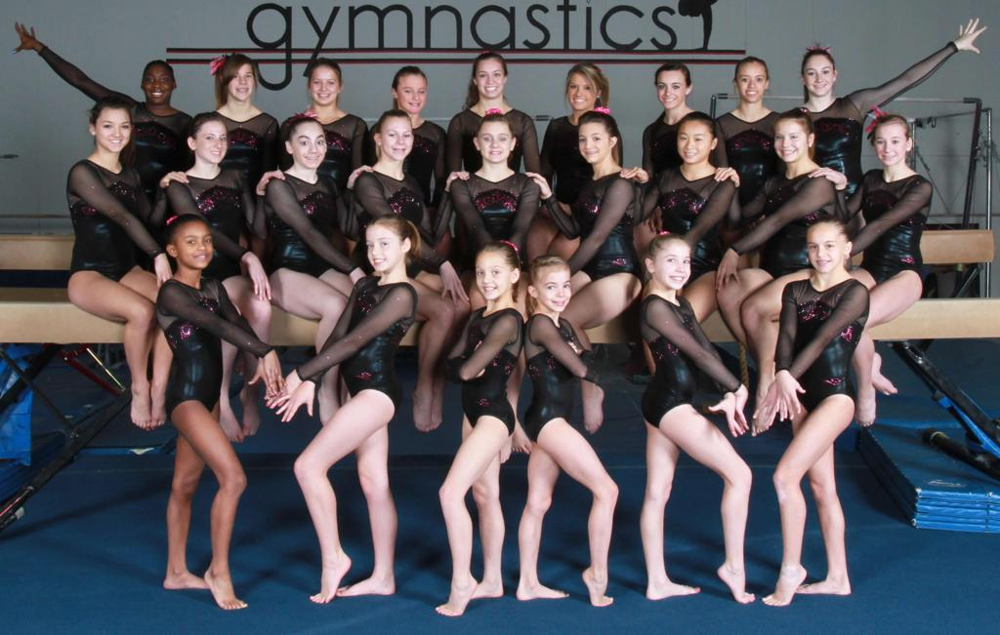

In [13]:
image, _ = load_image(IMAGES[2])
display_image(image)


Kaskada Haara


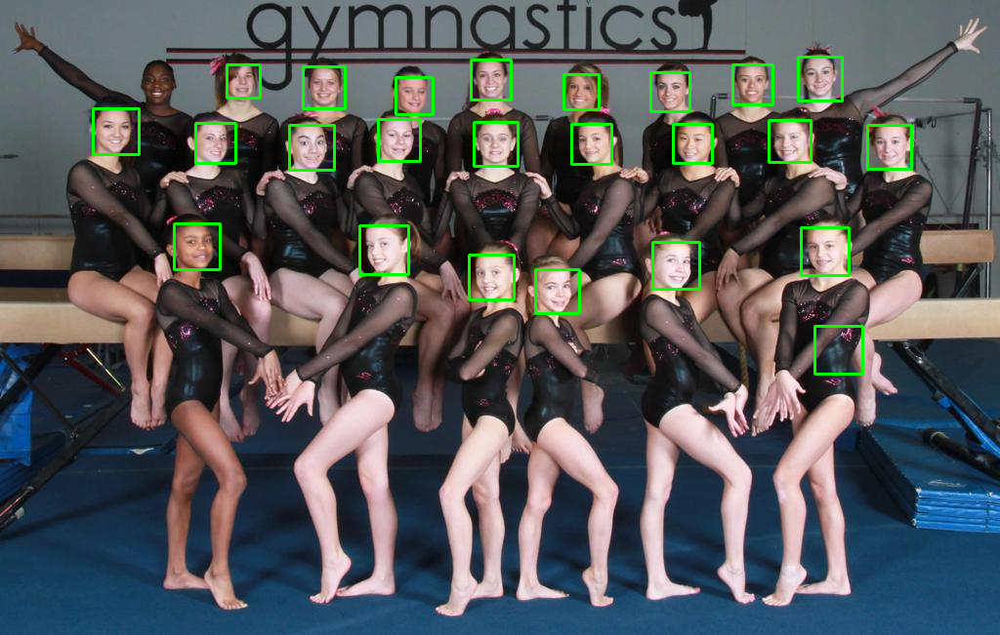

Typ Detektora: Haar
Liczba wykrytych twarzy na obrazie: 24
Liczba twarzy na obrazie (GT): 24
Liczba poprawnych detekcji twarzy na obrazie (TP): 23
Liczba fałszywych detekcji twarzy na obrazie (FP): 1
Liczba niezydentifikowanych twarzy na obrazie (FN): 1
Czas detekcji: 0.12s
Stosunek poprawnych detekcji do fałszywych: 23.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 0.96


In [14]:
print("\nKaskada Haara")
haar_image, haar_results, haar_time = haar_detect(IMAGES[2], haar_detector)
display_image(haar_image)
haar_results = process_detection_results(DETECTOR_TYPES[0], haar_results, haar_time, 24, 1)
haar_results_list.append(haar_results)
display_detection_results(haar_results)


HOG-SVM


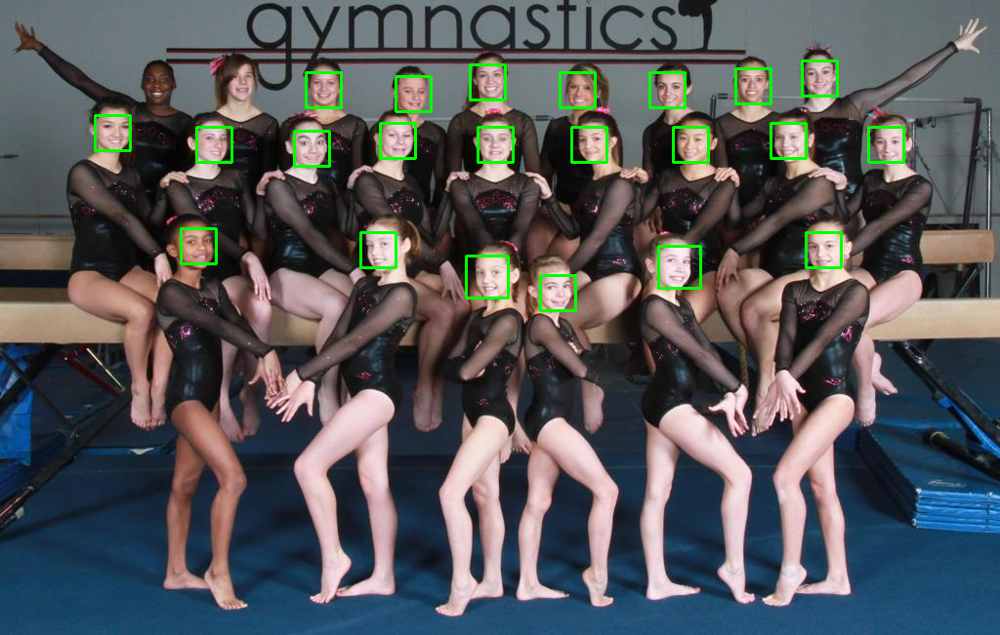

Typ Detektora: HOG SVM
Liczba wykrytych twarzy na obrazie: 22
Liczba twarzy na obrazie (GT): 24
Liczba poprawnych detekcji twarzy na obrazie (TP): 22
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 2
Czas detekcji: 0.28s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [15]:
print("\nHOG-SVM")
hog_svm_image, hog_svm_results, hog_svm_time = hog_svm_detect(IMAGES[2], hog_svm_detector)
display_image(hog_svm_image)
hog_svm_results = process_detection_results(DETECTOR_TYPES[1], hog_svm_results, hog_svm_time, 24, 0)
hog_svm_results_list.append(hog_svm_results)
display_detection_results(hog_svm_results)


CNN dlib


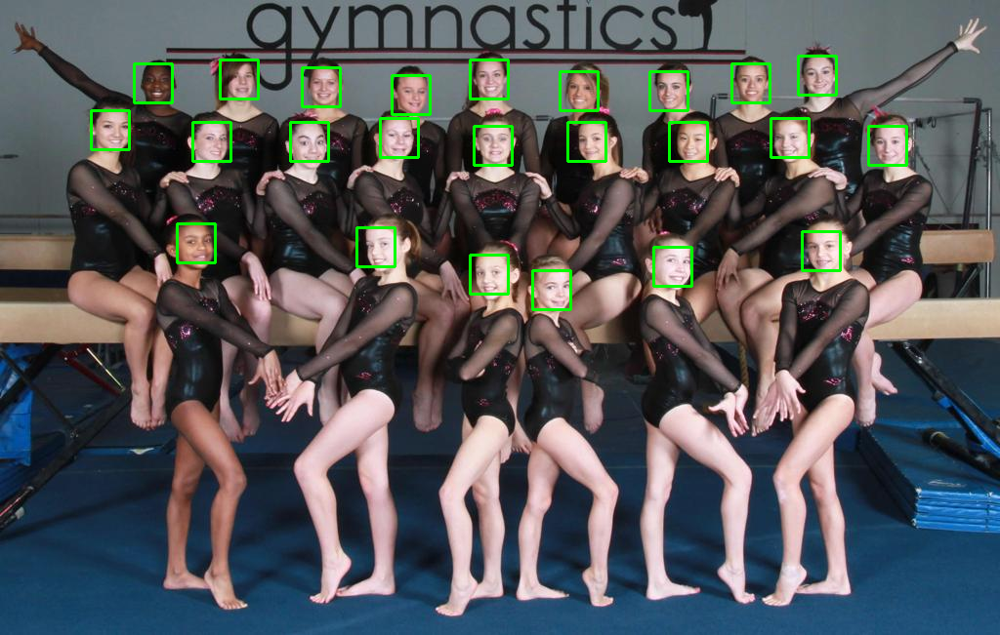

Typ Detektora: CNN
Liczba wykrytych twarzy na obrazie: 24
Liczba twarzy na obrazie (GT): 24
Liczba poprawnych detekcji twarzy na obrazie (TP): 24
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 0
Czas detekcji: 12.53s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [16]:
print("\nCNN dlib")
cnn_image, cnn_results, cnn_time = cnn_detect(IMAGES[2], cnn_detector)
display_image(cnn_image)
cnn_results = process_detection_results(DETECTOR_TYPES[2], cnn_results, cnn_time, 24, 0)
cnn_results_list.append(cnn_results)
display_detection_results(cnn_results)


InsightFace


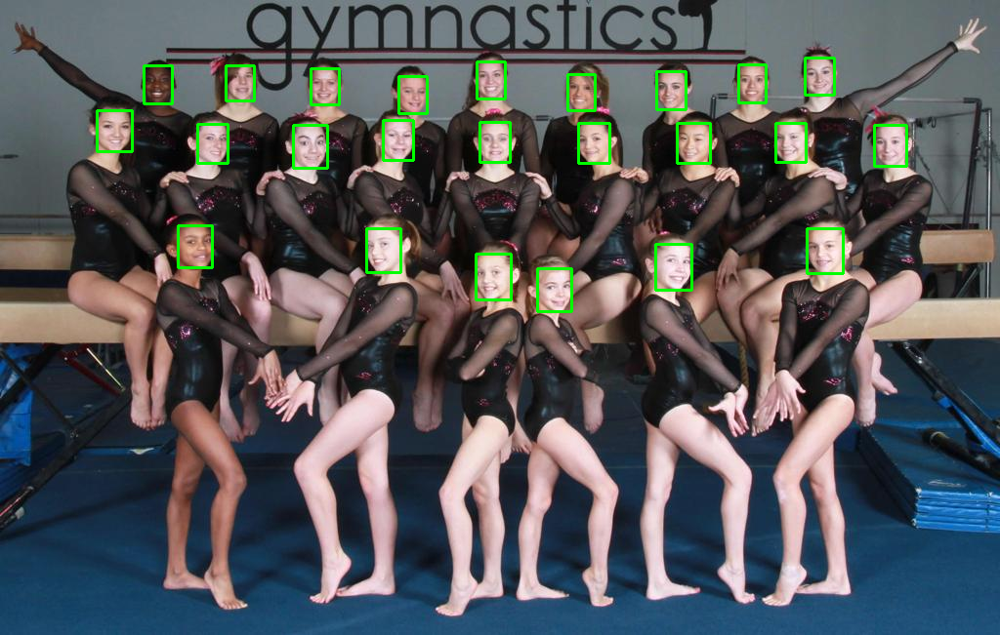

Typ Detektora: InsightFace
Liczba wykrytych twarzy na obrazie: 24
Liczba twarzy na obrazie (GT): 24
Liczba poprawnych detekcji twarzy na obrazie (TP): 24
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 0
Czas detekcji: 0.04s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [17]:
print("\nInsightFace")
insightface_image, insightface_results, insightface_time = insightface_detect(IMAGES[2], insf_detector)
display_image(insightface_image)
insightface_results = process_detection_results(DETECTOR_TYPES[3], insightface_results, insightface_time, 24, 0)
insightface_results_list.append(insightface_results)
display_detection_results(insightface_results)

#### WYNIKI

|  Detektor | Wykryte Twarze | GT | TP | FP | FN | Czas [s] | Poprawne/Fałszywe | Poprawne/Wszystkie |
|-----------|----------------|----|----|----|----|----------|-------------------|--------------------|
|Haar       |24              |24  |23  |1   |1   |0.12      |23.00              |0.96                |  
|HOG SVM    |22              |24  |22  |0   |2   |0.28      |0.00               |1.00                | 
|CNN        |24              |24  |24  |0   |0   |12.11     |0.00               |1.00                |  
|InsightFace|24              |24  |24  |0   |0   |0.06      |0.00               |1.00                | 

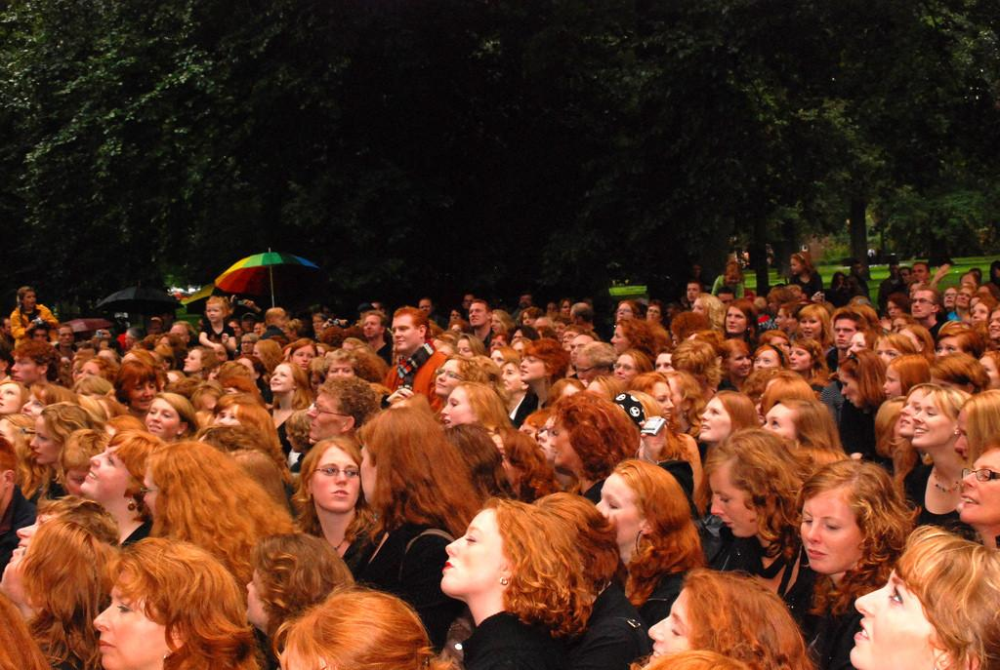

In [18]:
image, _ = load_image(IMAGES[3])
display_image(image)


Kaskada Haara


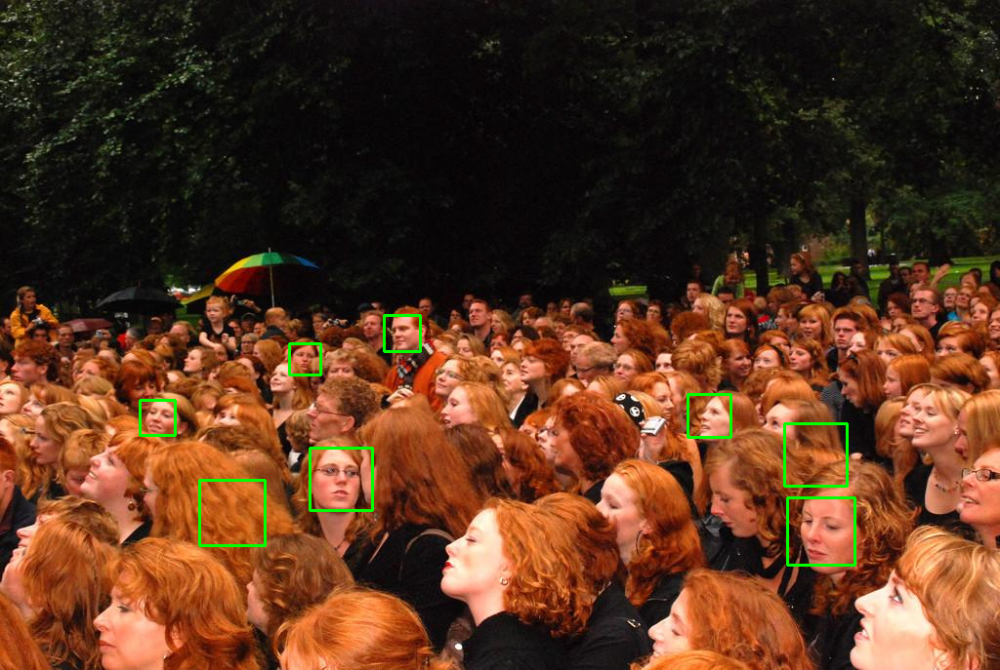

Typ Detektora: Haar
Liczba wykrytych twarzy na obrazie: 8
Liczba twarzy na obrazie (GT): 142
Liczba poprawnych detekcji twarzy na obrazie (TP): 6
Liczba fałszywych detekcji twarzy na obrazie (FP): 2
Liczba niezydentifikowanych twarzy na obrazie (FN): 136
Czas detekcji: 0.17s
Stosunek poprawnych detekcji do fałszywych: 3.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 0.75


In [19]:
print("\nKaskada Haara")
haar_image, haar_results, haar_time = haar_detect(IMAGES[3], haar_detector)
display_image(haar_image)
haar_results = process_detection_results(DETECTOR_TYPES[0], haar_results, haar_time, 142, 2)
haar_results_list.append(haar_results)
display_detection_results(haar_results)


HOG-SVM


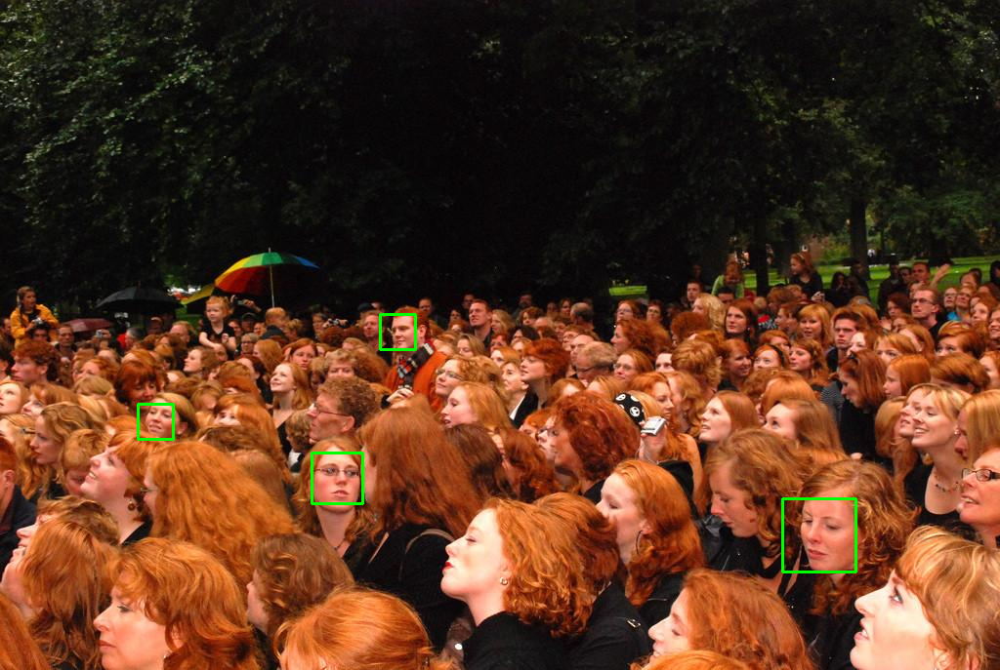

Typ Detektora: HOG SVM
Liczba wykrytych twarzy na obrazie: 4
Liczba twarzy na obrazie (GT): 142
Liczba poprawnych detekcji twarzy na obrazie (TP): 4
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 138
Czas detekcji: 0.24s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [20]:
print("\nHOG-SVM")
hog_svm_image, hog_svm_results, hog_svm_time = hog_svm_detect(IMAGES[3], hog_svm_detector)
display_image(hog_svm_image)
hog_svm_results = process_detection_results(DETECTOR_TYPES[1], hog_svm_results, hog_svm_time, 142, 0)
hog_svm_results_list.append(hog_svm_results)
display_detection_results(hog_svm_results)


CNN dlib


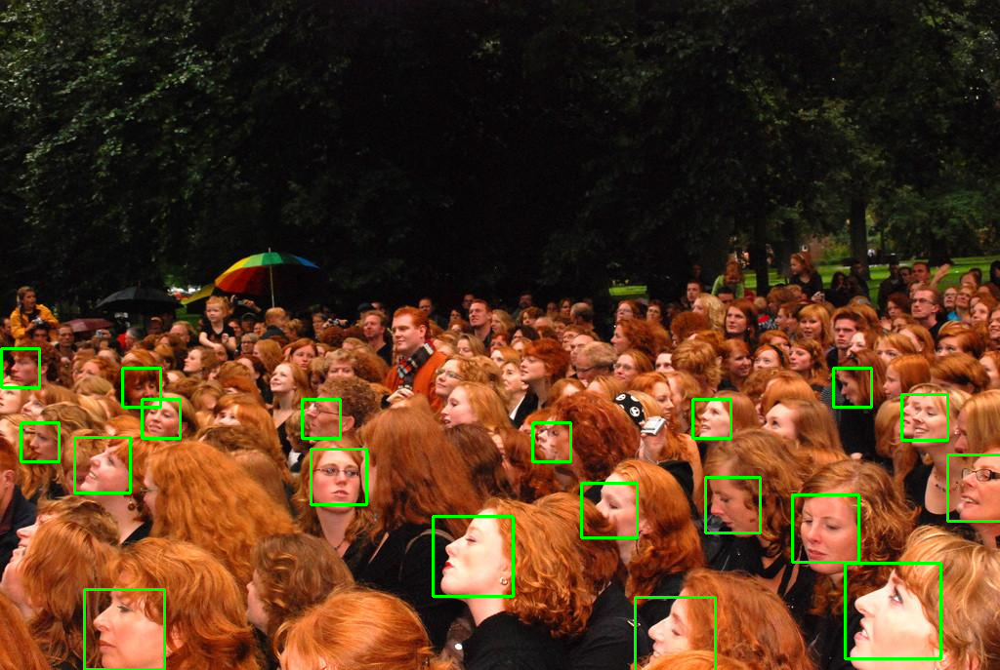

Typ Detektora: CNN
Liczba wykrytych twarzy na obrazie: 19
Liczba twarzy na obrazie (GT): 142
Liczba poprawnych detekcji twarzy na obrazie (TP): 19
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 123
Czas detekcji: 13.35s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [21]:
print("\nCNN dlib")
cnn_image, cnn_results, cnn_time = cnn_detect(IMAGES[3], cnn_detector)
display_image(cnn_image)
cnn_results = process_detection_results(DETECTOR_TYPES[2], cnn_results, cnn_time, 142, 0)
cnn_results_list.append(cnn_results)
display_detection_results(cnn_results)


InsightFace


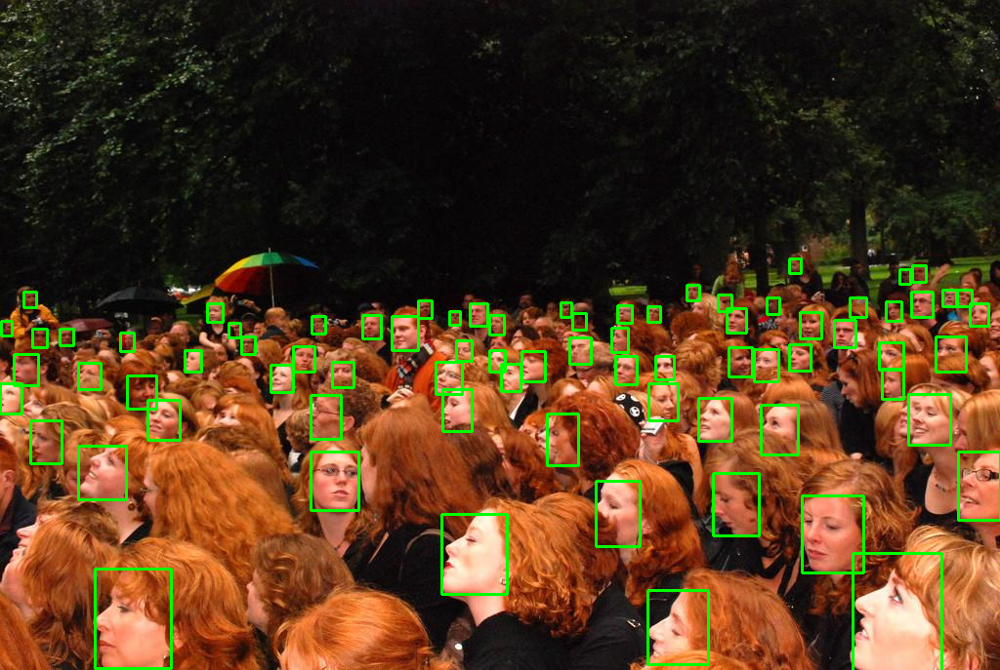

Typ Detektora: InsightFace
Liczba wykrytych twarzy na obrazie: 76
Liczba twarzy na obrazie (GT): 142
Liczba poprawnych detekcji twarzy na obrazie (TP): 76
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 66
Czas detekcji: 0.08s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [22]:
print("\nInsightFace")
insightface_image, insightface_results, insightface_time = insightface_detect(IMAGES[3], insf_detector)
display_image(insightface_image)
insightface_results = process_detection_results(DETECTOR_TYPES[3], insightface_results, insightface_time, 142, 0)
insightface_results_list.append(insightface_results)
display_detection_results(insightface_results)

#### WYNIKI

|  Detektor | Wykryte Twarze | GT | TP | FP | FN | Czas [s] | Poprawne/Fałszywe | Poprawne/Wszystkie |
|-----------|----------------|----|----|----|----|----------|-------------------|--------------------|
|Haar       |8               |142 |6   |2   |136 |0.10      |3.00               |0.75                |  
|HOG SVM    |4               |142 |4   |0   |138 |0.24      |0.00               |1.00                | 
|CNN        |19              |142 |19  |0   |123 |11.82     |0.00               |1.00                |  
|InsightFace|76              |142 |76  |0   |66  |0.06      |0.00               |1.00                | 


Wnioski podobne jak w zadaniu pierwszym, jednakże Haar i HOG SVM mogą wydawać się trochę rasistowskie (brak wykrycia twarzy osoby czarnej na tle białych) i dodatkowo wraz z CNN radzą sobie bardzo kiepsko na zdjęciach z tłumem.

### Zadanie 3

Wyznacz miary zaproponowane w pkt. 1 (włącznie z tymi już tam wymienionymi) łącznie dla 
wszystkich obrazów testowanych w pkt. 1 i pkt. 2. 

In [23]:
haar_combined_results = combine_results(DETECTOR_TYPES[0], haar_results_list)
display_combined_results(haar_combined_results)

Typ Detektora: Haar
Liczba wykrytych twarzy na obrazie: 63
Liczba twarzy na obrazie (GT): 282
Liczba poprawnych detekcji twarzy na obrazie (TP): 56
Liczba fałszywych detekcji twarzy na obrazie (FP): 7
Liczba niezydentifikowanych twarzy na obrazie (FN): 226
Czas detekcji: 0.60s


In [24]:
hog_svm_combined_results = combine_results(DETECTOR_TYPES[1], hog_svm_results_list)
display_combined_results(hog_svm_combined_results)

Typ Detektora: HOG SVM
Liczba wykrytych twarzy na obrazie: 54
Liczba twarzy na obrazie (GT): 282
Liczba poprawnych detekcji twarzy na obrazie (TP): 54
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 228
Czas detekcji: 0.98s


In [25]:
cnn_combined_results = combine_results(DETECTOR_TYPES[2], cnn_results_list)
display_combined_results(cnn_combined_results)

Typ Detektora: CNN
Liczba wykrytych twarzy na obrazie: 78
Liczba twarzy na obrazie (GT): 282
Liczba poprawnych detekcji twarzy na obrazie (TP): 78
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 204
Czas detekcji: 50.98s


In [26]:
insightface_combined_results = combine_results(DETECTOR_TYPES[3], insightface_results_list)
display_combined_results(insightface_combined_results)

Typ Detektora: InsightFace
Liczba wykrytych twarzy na obrazie: 162
Liczba twarzy na obrazie (GT): 282
Liczba poprawnych detekcji twarzy na obrazie (TP): 162
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 120
Czas detekcji: 0.24s


#### WYNIKI

| Detektor    | Wykryte Twarze | GT  | TP  | FP | FN  | Czas [s] |
|-------------|----------------|-----|-----|----|-----|----------|
| Haar        | 63             | 282 | 56  | 7  | 226 | 0.60     |
| HOG SVM     | 54             | 282 | 54  | 0  | 228 | 0.98     |
| CNN         | 78             | 282 | 78  | 0  | 204 | 50.98    |
| InsightFace | 162            | 282 | 162 | 0  | 120 | 0.24     |

### Zadanie 4

Detektory z biblioteki Dlib (hog_svm_detector i cnn1_detector w kodzie) mogą dokonać k-krotnego 
skalowania obrazu wejściowego (drugi parametr wywołania detektora). Również rozmiar obrazu dla 
detektora InsightFace można zmieniać (parametr det_size metody prepare). 
Sprawdź, jak na efektywność detekcji twarzy wpłynie zmiana rozmiaru analizowanego obrazu: dla 
detektorów z biblioteki Dlib zmień wartość parametru z 1 na 0 oraz na 2, dla detektora InsightFace 
dwukrotnie zmniejsz i zwiększ wartości w det_size.  
Jakie nowe twarze są znajdowane lub przestają być znajdowane? Wyznacz wartości miar 
zaproponowane w pkt. 1.


CNN dlib - 0


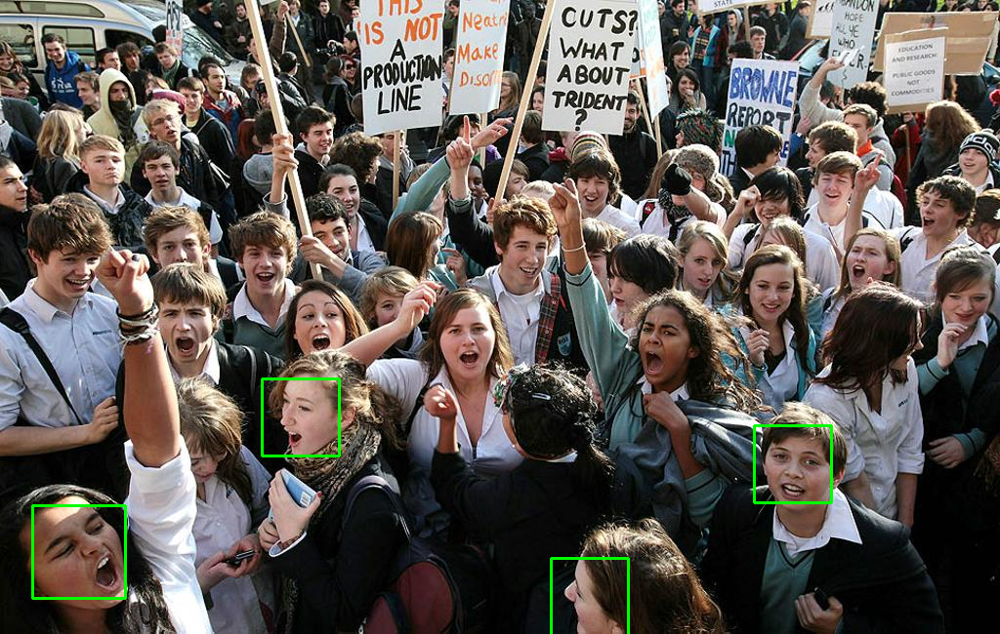

Typ Detektora: CNN
Liczba wykrytych twarzy na obrazie: 4
Liczba twarzy na obrazie (GT): 101
Liczba poprawnych detekcji twarzy na obrazie (TP): 4
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 97
Czas detekcji: 2.94s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [30]:
print("\nCNN dlib - 0")
cnn_image, cnn_results, cnn_time = cnn_detect(IMAGES[0], cnn_detector, 0)
display_image(cnn_image)
cnn_results = process_detection_results(DETECTOR_TYPES[2], cnn_results, cnn_time, 101, 0)
display_detection_results(cnn_results)


CNN dlib - 2


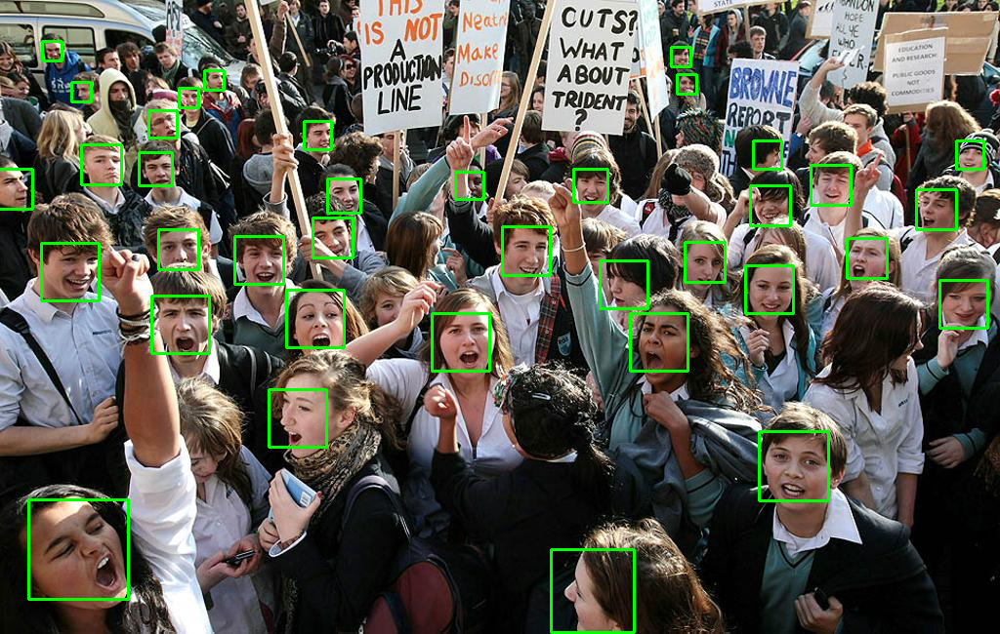

Typ Detektora: CNN
Liczba wykrytych twarzy na obrazie: 37
Liczba twarzy na obrazie (GT): 101
Liczba poprawnych detekcji twarzy na obrazie (TP): 37
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 64
Czas detekcji: 46.25s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [31]:
print("\nCNN dlib - 2")
cnn_image, cnn_results, cnn_time = cnn_detect(IMAGES[0], cnn_detector, 2)
display_image(cnn_image)
cnn_results = process_detection_results(DETECTOR_TYPES[2], cnn_results, cnn_time, 101, 0)
display_detection_results(cnn_results)

Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: config/insightface/models/buffalo_s/det_500m.onnx detection [1, 3, '?', '?'] 127.5 128.0
set det-size: (512, 512)

InsightFace - 512


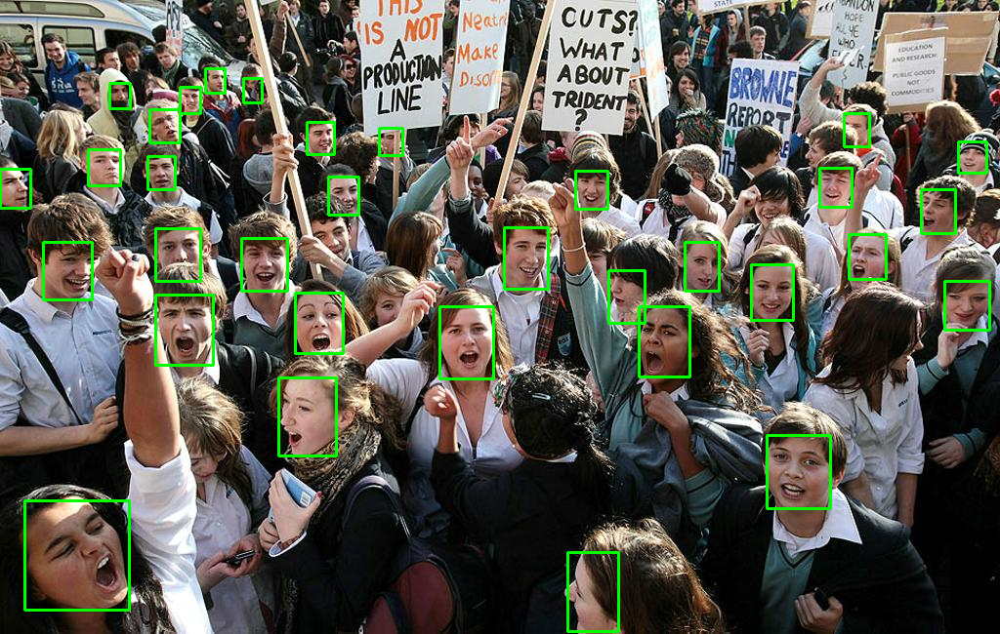

Typ Detektora: InsightFace
Liczba wykrytych twarzy na obrazie: 33
Liczba twarzy na obrazie (GT): 101
Liczba poprawnych detekcji twarzy na obrazie (TP): 33
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 68
Czas detekcji: 0.02s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [32]:
insf_detector = insightface.app.FaceAnalysis(name=INSIGTHFACE_MODELS[0], root=f"{CONFIG_DIR}/{INSIGHTFACE_CONFIG}", providers=['CPUExecutionProvider'], allowed_modules=['detection'])
insf_detector.prepare(ctx_id=0, det_size=(512, 512))

print("\nInsightFace - 512")
insightface_image, insightface_results, insightface_time = insightface_detect(IMAGES[0], insf_detector)
display_image(insightface_image)
insightface_results = process_detection_results(DETECTOR_TYPES[3], insightface_results, insightface_time, 101, 0)
display_detection_results(insightface_results)

Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: config/insightface/models/buffalo_s/det_500m.onnx detection [1, 3, '?', '?'] 127.5 128.0
set det-size: (2048, 2048)

InsightFace - 2048


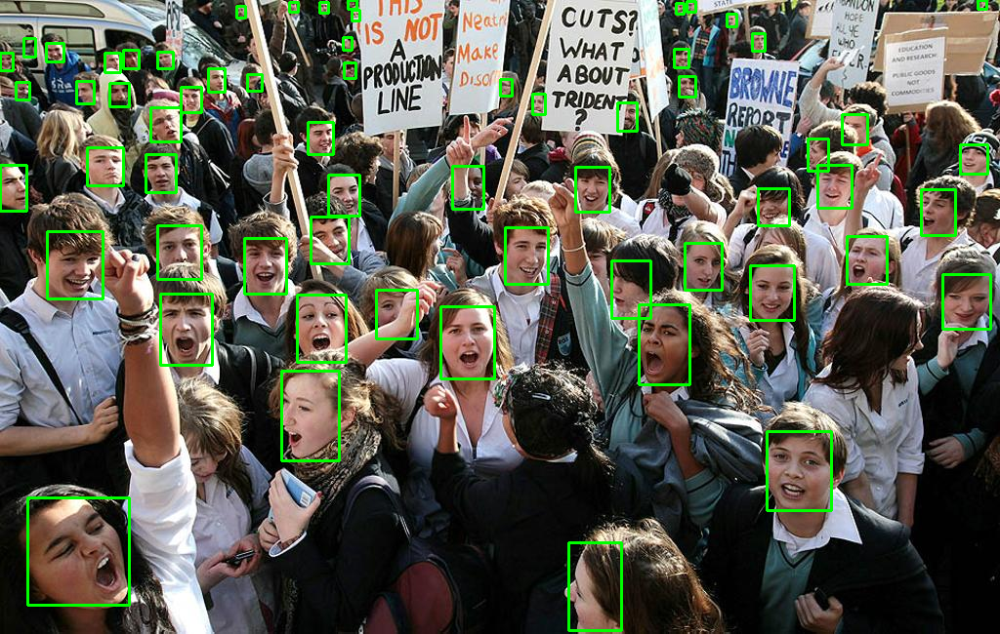

Typ Detektora: InsightFace
Liczba wykrytych twarzy na obrazie: 62
Liczba twarzy na obrazie (GT): 101
Liczba poprawnych detekcji twarzy na obrazie (TP): 62
Liczba fałszywych detekcji twarzy na obrazie (FP): 0
Liczba niezydentifikowanych twarzy na obrazie (FN): 39
Czas detekcji: 0.16s
Stosunek poprawnych detekcji do fałszywych: 0.00
Stosunek poprawnych detekcji do wszystkich wykrytych: 1.00


In [34]:
insf_detector = insightface.app.FaceAnalysis(name=INSIGTHFACE_MODELS[0], root=f"{CONFIG_DIR}/{INSIGHTFACE_CONFIG}", providers=['CPUExecutionProvider'], allowed_modules=['detection'])
insf_detector.prepare(ctx_id=0, det_size=(2048, 2048))

print("\nInsightFace - 2048")
insightface_image, insightface_results, insightface_time = insightface_detect(IMAGES[0], insf_detector)
display_image(insightface_image)
insightface_results = process_detection_results(DETECTOR_TYPES[3], insightface_results, insightface_time, 101, 0)
display_detection_results(insightface_results)

#### WYNIKI

| Detektor            | Wykryte Twarze | GT  | TP  | FP | FN  | Czas [s] | Poprawne/Fałszywe | Poprawne/Wszystkie |
|---------------------|----------------|-----|-----|----|-----|----------|-------------------|--------------------|
| CNN 0               | 4              | 101 | 4   | 0  | 97  | 2.94     | 0.00              | 1.00               |
| CNN 2               | 37             | 101 | 37  | 0  | 64  | 46.25    | 0.00              | 1.00               |
| InsightFace - 512   | 33             | 101 | 33  | 0  | 68  | 0.02     | 0.00              | 1.00               |
| InsightFace - 2048  | 62             | 101 | 62  | 0  | 39  | 0.16s    | 0.00              | 1.00               |


Po zmianie na 0 w CNN poradził on sobie zdecydowanie gorzej, po zmianie na 2 lepiej, ale ilość czasu wymagana do wykrycia jest niesatysfakcjonująca.
Po zmianie rozmiaru na mniejszy Insight poradził sobie dużo gorzej, aczkolwiek zrobił to bardzo szybko, natomiast po zwiększeniu rozmiaru poradził sobie lepiej niż za pierwszym razem i to niewielkim zwiększeniem czasu.

Wykrywane są też mniejsze twarze i bardziej oddalone (w lepszych wersjach).